# Machine Learning Project

**@author : Camille Bordes**

**@email : camille.bordes@efrei.net**

**@group: DAI**

## Data Preprocessing

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

In [188]:
df = pd.read_csv('diabetes.csv')

In [189]:
df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [190]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [191]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [368]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Pima Indians Diabetes Dataset")
profile.to_notebook_iframe()
profile.to_file('pima_indians_diabetes_dataset_report.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

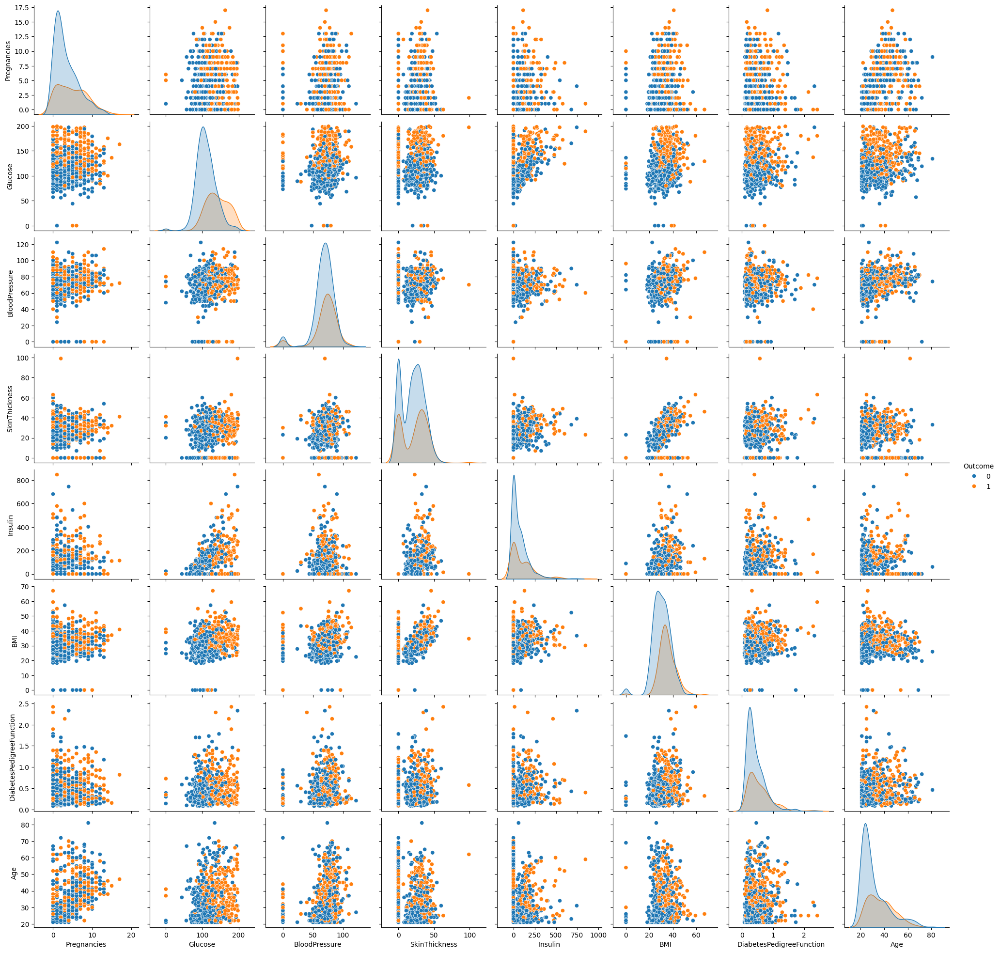

In [193]:
%matplotlib inline
sns.pairplot(df, hue='Outcome')
plt.show()

By analyzing the dataset, we see that the target variable is “Outcome”, which is a categorical variable, and the other 8 variables are numerical.

We can also see that the dataset  contains many aberant values. We can therefore try to make two DataFrames: one (df_without_zeros) in which we remove them and one (df_median) in which we replace them with the medians of the columns so as not to alter the data too much.

But we can even say that it's a good dataset, because by analyzing the distribution of classes, we can see that they mostly follow the Normal distribution, like: Glucose, BloodPressure, SkinThickness, BMI. The DiabetesPedigreeFunction and Age variables seem to follow an Exponential distribution, as they both decrease quite rapidly.

Analysis of the correlation matrix and the pairplot from seaborn shows that the most significant variables are Glucose, BMI and Age. And the worst are BloodPressure and Insulin.

In [194]:
# Show the different aberrant values
df[(df['Insulin'] == 0) | (df['SkinThickness'] == 0) |  (df['Glucose'] == 0) | (df['BloodPressure'] == 0) | (df['BMI'] == 0)]

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
5,5,116,74,0,0,25.6,0.201,30,0
7,10,115,0,0,0,35.3,0.134,29,0
...,...,...,...,...,...,...,...,...,...
761,9,170,74,31,0,44.0,0.403,43,1
762,9,89,62,0,0,22.5,0.142,33,0
764,2,122,70,27,0,36.8,0.340,27,0
766,1,126,60,0,0,30.1,0.349,47,1


**We decide not to delete the 0 in the Insulin column, as this would remove too many rows.**

In [195]:
df_without_zeros = df[(df['SkinThickness']!=0) & (df['Glucose']!=0) & (df['BloodPressure']!=0) & (df['BMI']!=0)]
df_without_zeros

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
6,3,78,50,32,88,31.0,0.248,26,1
...,...,...,...,...,...,...,...,...,...
761,9,170,74,31,0,44.0,0.403,43,1
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0


**Here we replace the missing values by the median of the columns.**

In [196]:
df_median = df.copy()

filtered_df = df_median[(df_median['Insulin'] == 0) | (df_median['SkinThickness'] == 0) |  (df_median['Glucose'] == 0) | (df_median['BloodPressure'] == 0) | (df_median['BMI'] == 0)]
df_without_zeros_temp = df_median.drop(filtered_df.index)

for column in ['Insulin', 'SkinThickness', 'Glucose', 'BloodPressure', 'BMI']:
    for outcome_value in df_median['Outcome'].unique():
        median = df_without_zeros_temp[df_without_zeros_temp['Outcome'] == outcome_value][column].median()
        df_median.loc[(df_median['Outcome'] == outcome_value) & (df_median[column] == 0), column] = median

df_median

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72,35,169.5,33.6,0.627,50,1
1,1,85.0,66,29,105.0,26.6,0.351,31,0
2,8,183.0,64,33,169.5,23.3,0.672,32,1
3,1,89.0,66,23,94.0,28.1,0.167,21,0
4,0,137.0,40,35,168.0,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76,48,180.0,32.9,0.171,63,0
764,2,122.0,70,27,105.0,36.8,0.340,27,0
765,5,121.0,72,23,112.0,26.2,0.245,30,0
766,1,126.0,60,33,169.5,30.1,0.349,47,1


**Splitting, Standardization and PCA on df_without_zeros**

Since df_without_zeros still contains some aberrant values, it might be very interesting to apply a PCA to it

In [197]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

We start by separating the data into train and test data and then standardizing them. We can then initialize the PCA and calculate the cumulative explained variance, which will exceed 95% to be sure of finding the optimum number of dimensions with maximum precision.

In [198]:
X_train_df_without_zeros, X_test_df_without_zeros, y_train_df_without_zeros, y_test_df_without_zeros = train_test_split(df_without_zeros.iloc[:, :-1], df_without_zeros['Outcome'], test_size=0.2, random_state=42)

scaler1 = StandardScaler()
X_train_df_without_zeros_scaled = scaler1.fit_transform(X_train_df_without_zeros)
X_test_df_without_zeros_scaled = scaler1.transform(X_test_df_without_zeros)

pca1 = PCA()
X_train_df_without_zeros_scaled_PCA = pca1.fit_transform(X_train_df_without_zeros_scaled)
X_test_df_without_zeros_scaled_PCA = pca1.transform(X_test_df_without_zeros_scaled)

In [199]:
explained_variance = pca1.explained_variance_ratio_
print(f"Variance explained by each component: \n{explained_variance}")

cumulative_variance = np.cumsum(explained_variance)
rate = 0.95
n_components_optimal = np.argmax(cumulative_variance >= rate) + 1
print(f"Number of components to explain {rate*100}% of variance: {n_components_optimal}")

Variance explained by each component: 
[0.30527833 0.19717773 0.14820629 0.11524511 0.08987587 0.06343347
 0.0456272  0.03515601]
Number of components to explain 95.0% of variance: 7


Then initialize the PCA with the optimal number of coponents found (7).

In [200]:
pca2 = PCA(n_components=n_components_optimal)
X_train_df_without_zeros_scaled_PCA = pca2.fit_transform(X_train_df_without_zeros_scaled)
X_test_df_without_zeros_scaled_PCA = pca2.transform(X_test_df_without_zeros_scaled)

In [201]:
explained_variance = pca2.explained_variance_ratio_
print(f"Variance explained by each component: \n{explained_variance}")

Variance explained by each component: 
[0.30527833 0.19717773 0.14820629 0.11524511 0.08987587 0.06343347
 0.0456272 ]


**Splitting and Standardization on df_median**

In [202]:
X_train_df_median, X_test_df_median, y_train_df_median, y_test_df_median = train_test_split(df_median.iloc[:, :-1], df_median['Outcome'], test_size=0.2, random_state=42)

scaler1 = StandardScaler()
X_train_df_median_scaled = scaler1.fit_transform(X_train_df_median)
X_test_df_median_scaled = scaler1.transform(X_test_df_median)

## Testing models, Evaluation and Hyperparameter Tuning

In [265]:
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

In [312]:
def confusionMatrix(cm):
    plt.figure(figsize=(4,3))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.yticks(rotation=0)
    plt.xlabel('Predictions')
    plt.ylabel('True Values')
    plt.title('Confusion Matrix')
    plt.show()

def modelEvaluation(y_test, y_pred):
    print("Accuracy:", accuracy_score(y_test, y_pred), '\n')
    print("Classification Report:\n\n", classification_report(y_test, y_pred))
    confusionMatrix(confusion_matrix(y_test, y_pred))

global metrics_models

metrics_models= {'Name': [],
                 'Accuracy Macro': [], 
                 'Precision Macro': [], 
                 'Recall Macro': [], 
                 'F1 Macro': []}

def addMetrics(model, y_test, y_pred):
    metrics_models['Name'].append(model)
    metrics_models['Accuracy Macro'].append(accuracy_score(y_test, y_pred))
    metrics_models['Precision Macro'].append(precision_score(y_test, y_pred))
    metrics_models['Recall Macro'].append(recall_score(y_test, y_pred))
    metrics_models['F1 Macro'].append(f1_score(y_test, y_pred))

### **Logistic Regression**

In [158]:
from sklearn.linear_model import LogisticRegression

#### Testing Logisitc Regression on df_without_zeros

Accuracy: 0.822429906542056 

Classification Report:

               precision    recall  f1-score   support

           0       0.86      0.89      0.87        74
           1       0.73      0.67      0.70        33

    accuracy                           0.82       107
   macro avg       0.80      0.78      0.79       107
weighted avg       0.82      0.82      0.82       107



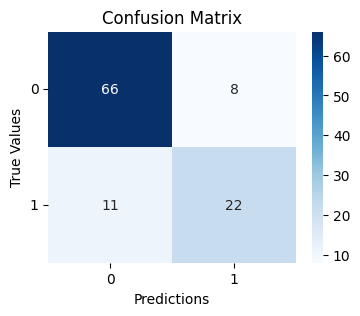

In [159]:
lr1 = LogisticRegression()
lr1.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)
y_pred_df_without_zeros = lr1.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)

#### Testing Logistic Regression on df_median

Accuracy: 0.7857142857142857 

Classification Report:

               precision    recall  f1-score   support

           0       0.82      0.85      0.84        99
           1       0.71      0.67      0.69        55

    accuracy                           0.79       154
   macro avg       0.77      0.76      0.76       154
weighted avg       0.78      0.79      0.78       154



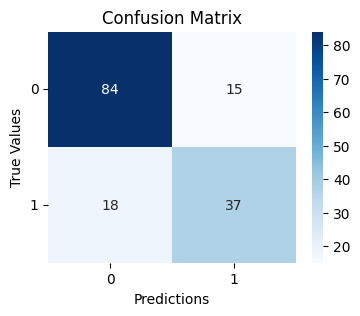

In [160]:
lr2 = LogisticRegression()
lr2.fit(X_train_df_median_scaled, y_train_df_median)
y_pred_df_median = lr2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)

#### We see that it's better with df_without_zeros so let's do a Grid Search with them to find the best hyperparametors

We create a pipeline with the different processing steps.

In our case we must do a standardization, a PCA and the logistic regression.

The pipeline is very important because there is always a cross validation in a grid search, so you should not send it already standardized data in order to avoid a data leak. So that a new standardization is done on each step of the cross validation.

In [169]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=n_components_optimal)),
    ('log_reg', LogisticRegression())
])

# We define the grid of important hyperparameters that we want to test on a list of values
param_grid = {
    'log_reg__C': [0.1, 1, 10, 100], # Differents values of Inverse of Regularization Strength
    'log_reg__penalty': ['l1', 'l2'], # Specify the norm of the penalty
    'log_reg__solver': ['lbfgs', 'liblinear', 'sag', 'saga'], # Choose the alogorithm to use with the penality
    'log_reg__max_iter': [100, 200, 300, 400, 500] # Values of the maximum number of iterations
}

# We initialize the Grid Search with the pipeline, and the grid of parameters, 
# giving it a 5-step cross validation which will have to be based on accuracy to evaluate the best of the hyperparameter combinations.
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy')

grid_search.fit(X_train_df_without_zeros, y_train_df_without_zeros)

best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

Best Hyperparameters: {'log_reg__C': 0.1, 'log_reg__max_iter': 100, 'log_reg__penalty': 'l2', 'log_reg__solver': 'liblinear'}
Accuracy: 0.822429906542056


c:\Python311\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
200 fits failed out of a total of 800.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
100 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Python311\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Python311\Lib\site-packages\sklearn\pipeline.py", line 473, in fit
    self._final_estimator.fit(Xt, y, **last_step_params["fit"])
  File "c:

#### Finally, we test the best combination of hyperparameters on the Logistic Regression

Accuracy: 0.822429906542056 

Classification Report:

               precision    recall  f1-score   support

           0       0.86      0.89      0.87        74
           1       0.73      0.67      0.70        33

    accuracy                           0.82       107
   macro avg       0.80      0.78      0.79       107
weighted avg       0.82      0.82      0.82       107



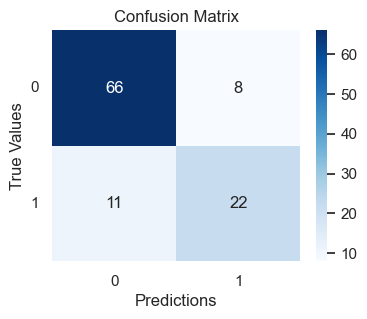

In [313]:
lr3 = LogisticRegression(C=0.1, max_iter=100, penalty='l2', solver='liblinear')
lr3.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)
y_pred_df_without_zeros = lr3.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)
addMetrics('LogisticRegression', y_test_df_without_zeros, y_pred_df_without_zeros)

### **K-Nearest Neighbors (K-NN)**

In [164]:
from sklearn.neighbors import KNeighborsClassifier

#### Testing KNN on df_without_zeros

Accuracy: 0.7570093457943925 

Classification Report:

               precision    recall  f1-score   support

           0       0.82      0.84      0.83        74
           1       0.61      0.58      0.59        33

    accuracy                           0.76       107
   macro avg       0.71      0.71      0.71       107
weighted avg       0.75      0.76      0.75       107



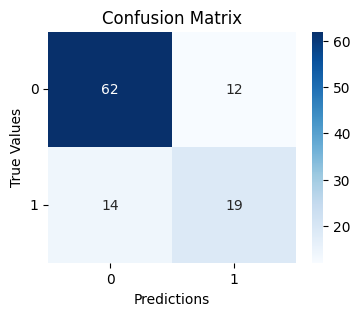

In [165]:
knn1 = KNeighborsClassifier()
knn1.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)
y_pred_df_without_zeros = knn1.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)

#### Testing KNN on df_median

Accuracy: 0.8181818181818182 

Classification Report:

               precision    recall  f1-score   support

           0       0.88      0.83      0.85        99
           1       0.72      0.80      0.76        55

    accuracy                           0.82       154
   macro avg       0.80      0.81      0.81       154
weighted avg       0.82      0.82      0.82       154



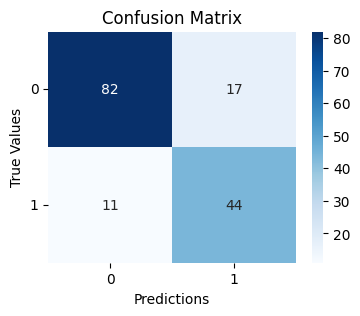

In [166]:
knn2 = KNeighborsClassifier()
knn2.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = knn2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)

#### We see that it's better with df_median so let's do a Grid Search with them

In [174]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('knn', KNeighborsClassifier())
])

param_grid= {
    'knn__n_neighbors': [3, 5, 7, 9, 11], # Number of neighbors
    'knn__weights': ['uniform', 'distance'], # Weight function used in prediction
    'knn__algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'], # Algorithm used to compute the nearest neighbors
    'knn__metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski'], # Distance Metrics
    'knn__p': [1, 2], # Only for Minkowski metric : Manhattan distance or Euclidienne distance
}

grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy')

grid_search.fit(X_train_df_median, y_train_df_median)

print("Meilleurs hyperparamètres:", grid_search.best_params_)

Meilleurs hyperparamètres: {'knn__algorithm': 'auto', 'knn__metric': 'manhattan', 'knn__n_neighbors': 9, 'knn__p': 1, 'knn__weights': 'distance'}


#### Finally, we test the best combination of hyperparameters on the KNN

Accuracy: 0.8376623376623377 

Classification Report:

               precision    recall  f1-score   support

           0       0.88      0.87      0.87        99
           1       0.77      0.78      0.77        55

    accuracy                           0.84       154
   macro avg       0.82      0.83      0.82       154
weighted avg       0.84      0.84      0.84       154



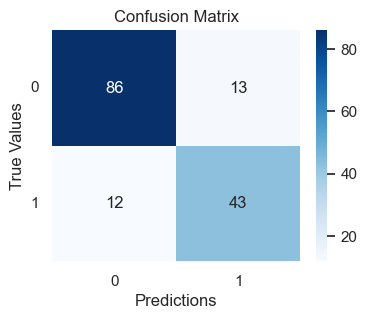

In [314]:
knn2 = KNeighborsClassifier(algorithm='auto', metric='manhattan', n_neighbors=9, p=1, weights='distance')
knn2.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = knn2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)
addMetrics('KNeighborsClassifier', y_test_df_median, y_pred_df_median)

### **Multi-layer Perceptron Classifier (MLP-Classifer)**

In [171]:
from sklearn.neural_network import MLPClassifier

#### Testing MPL-Classifer on df_without_zeros

Accuracy: 0.7663551401869159 

Classification Report:

               precision    recall  f1-score   support

           0       0.83      0.84      0.83        74
           1       0.62      0.61      0.62        33

    accuracy                           0.77       107
   macro avg       0.73      0.72      0.72       107
weighted avg       0.76      0.77      0.77       107



c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


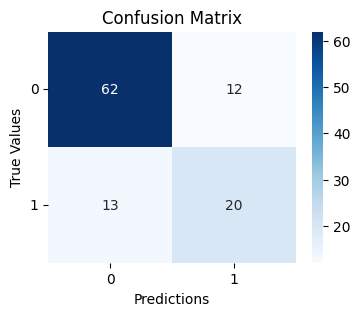

In [172]:
mlp1 = MLPClassifier(random_state=42)
mlp1.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)

y_pred_df_without_zeros = mlp1.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)

#### Testing MLP-Classifer on df_median

Accuracy: 0.8311688311688312 

Classification Report:

               precision    recall  f1-score   support

           0       0.88      0.85      0.87        99
           1       0.75      0.80      0.77        55

    accuracy                           0.83       154
   macro avg       0.81      0.82      0.82       154
weighted avg       0.83      0.83      0.83       154



c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


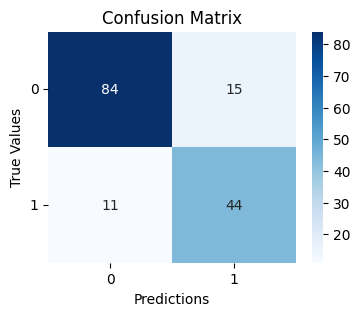

In [173]:
mlp2 = MLPClassifier(random_state=42)
mlp2.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = mlp2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)

#### We see that it's better with df_median so let's do a Grid Search with them

In [176]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('mlp', MLPClassifier(random_state=42))
])

param_grid = {
    'mlp__hidden_layer_sizes': [(10,), (50,), (100,), (50, 50), (128, 64, 32)], # Sizes of hidden layers (tuple)
    'mlp__activation': ['identity', 'logistic', 'tanh', 'relu'], # Activation function for the hidden layer
    'mlp__solver': ['lbfgs', 'sgd', 'adam'], # Algorithm (the solver) for weight optimization
    'mlp__alpha': [0.0001, 0.001, 0.01, 0.1], # L2 penalty (regularization term) parameter
    'mlp__max_iter': [200, 300, 400], # Maximum number of iterations
}

grid_search = GridSearchCV(pipeline, param_grid, cv=4, scoring='accuracy')

grid_search.fit(X_train_df_median, y_train_df_median)

print("Meilleurs hyperparamètres:", grid_search.best_params_)

y_pred_df_median = grid_search.best_estimator_.predict(X_test_df_median)
print("Accuracy:", accuracy_score(y_test_df_median, y_pred_df_median))

c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:545: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:545: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of

Meilleurs hyperparamètres: {'mlp__activation': 'relu', 'mlp__alpha': 0.0001, 'mlp__hidden_layer_sizes': (100,), 'mlp__max_iter': 300, 'mlp__solver': 'adam'}
Accuracy: 0.8376623376623377


c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


#### Finally, we test the best combination of hyperparameters on the MLP-Classifer

Accuracy: 0.8376623376623377 

Classification Report:

               precision    recall  f1-score   support

           0       0.89      0.86      0.87        99
           1       0.76      0.80      0.78        55

    accuracy                           0.84       154
   macro avg       0.82      0.83      0.83       154
weighted avg       0.84      0.84      0.84       154



c:\Python311\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


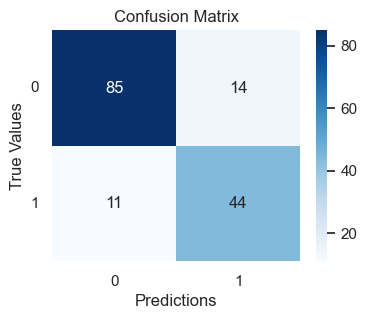

In [315]:
mlp3 = MLPClassifier(random_state=42, activation='relu', alpha= 0.0001, hidden_layer_sizes=(100,), max_iter=300, solver='adam')
mlp3.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = mlp3.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)
addMetrics('MLPClassifier', y_test_df_median, y_pred_df_median)

### **Decision Tree**

In [205]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

In [300]:
def plotDecisionTree(dtc):
    plt.figure(figsize=(100,100))
    tree.plot_tree(dtc, filled=True, rounded=True, feature_names=df.iloc[:, :-1].columns, fontsize=30)
    plt.title("Plot Decision Tree")
    plt.show()

#### Testing Decision Tree on df_without_zeros

Accuracy: 0.7102803738317757 

Classification Report:

               precision    recall  f1-score   support

           0       0.80      0.77      0.79        74
           1       0.53      0.58      0.55        33

    accuracy                           0.71       107
   macro avg       0.67      0.67      0.67       107
weighted avg       0.72      0.71      0.71       107



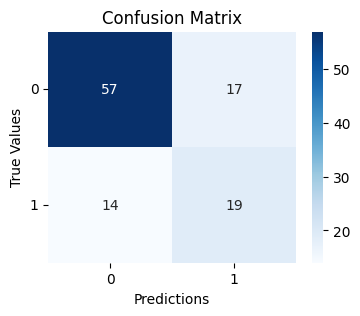

In [262]:
dtc1 = DecisionTreeClassifier(random_state=42)
dtc1.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)

y_pred_df_without_zeros = dtc1.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)
plotDecisionTree(dtc1)

#### Testing Decision Tree on df_median

Accuracy: 0.8441558441558441 

Classification Report:

               precision    recall  f1-score   support

           0       0.89      0.86      0.88        99
           1       0.76      0.82      0.79        55

    accuracy                           0.84       154
   macro avg       0.83      0.84      0.83       154
weighted avg       0.85      0.84      0.85       154



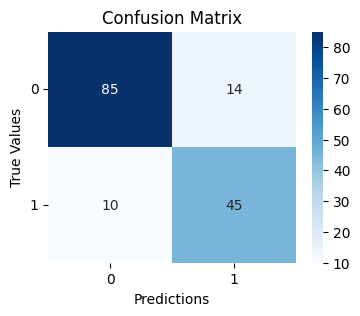

In [263]:
dtc2 = DecisionTreeClassifier(random_state=42)
dtc2.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = dtc2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)
plotDecisionTree(dtc2)

#### We see that it's better with df_median so let's do a Grid Search with them

In [210]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('dtc', DecisionTreeClassifier(random_state=42))
])

param_grid = {
    'dtc__criterion': ['gini', 'entropy', 'log_loss'], # Function to measure the quality of a split
    'dtc__splitter': ['best', 'random'], # Strategy to choose the split at each node
    'dtc__max_depth': [None, 10, 20, 30, 40], # Maximum depth of the tree
    'dtc__min_samples_split': [2, 10, 20], # Minimum number of samples required to split a node
    'dtc__min_samples_leaf': [1, 5, 10], # Minimum number of samples required to be at a leaf node
    'dtc__max_features': [None, 'sqrt', 'log2'], # Number of features to consider when looking for the best split
    'dtc__max_leaf_nodes': [None, 10, 20, 30], # Grow a tree with a max number of leaf nodes
}

grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='accuracy')

grid_search.fit(X_train_df_median, y_train_df_median)

print("Meilleurs hyperparamètres:", grid_search.best_params_)

y_pred_df_median = grid_search.best_estimator_.predict(X_test_df_median)
print("Accuracy:", accuracy_score(y_test_df_median, y_pred_df_median))

Meilleurs hyperparamètres: {'dtc__criterion': 'entropy', 'dtc__max_depth': None, 'dtc__max_features': None, 'dtc__max_leaf_nodes': 20, 'dtc__min_samples_leaf': 1, 'dtc__min_samples_split': 10, 'dtc__splitter': 'best'}
Accuracy: 0.8441558441558441


#### Finally, we test the best combination of hyperparameters on the Decision Tree

Accuracy: 0.8441558441558441 

Classification Report:

               precision    recall  f1-score   support

           0       0.88      0.88      0.88        99
           1       0.78      0.78      0.78        55

    accuracy                           0.84       154
   macro avg       0.83      0.83      0.83       154
weighted avg       0.84      0.84      0.84       154



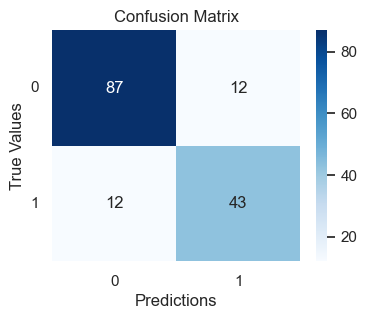

In [316]:
dtc3 = DecisionTreeClassifier(random_state=42, criterion='entropy', max_depth=None, max_features=None, max_leaf_nodes=20, min_samples_leaf=1, min_samples_split=10, splitter='best')
dtc3.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = dtc3.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)
addMetrics('DecisionTreeClassifier', y_test_df_median, y_pred_df_median)
plotDecisionTree(dtc3)

### **Random Forest**

In [214]:
from sklearn.ensemble import RandomForestClassifier

In [363]:
def featureImportance(rfc, df):
    features = df.columns[:-1]
    
    importance_df = pd.DataFrame({'Feature': features, 'Importance': rfc.feature_importances_})
    importance_df = importance_df.sort_values(by='Importance', ascending=True)

    plt.figure(figsize=(10, 6))
    plt.barh(importance_df['Feature'], importance_df['Importance'], align='center')
    plt.xlabel("Feature Importance")
    plt.ylabel("Features")
    plt.title("Random Forest - Feature Importance")
    plt.xlim(0, max(importance_df['Importance']) * 1.1)  # Optionnel : ajuster l'axe x
    plt.show()

#### Testing Random Forest on df_without_zeros

Accuracy: 0.7570093457943925 

Classification Report:

               precision    recall  f1-score   support

           0       0.82      0.84      0.83        74
           1       0.61      0.58      0.59        33

    accuracy                           0.76       107
   macro avg       0.71      0.71      0.71       107
weighted avg       0.75      0.76      0.75       107



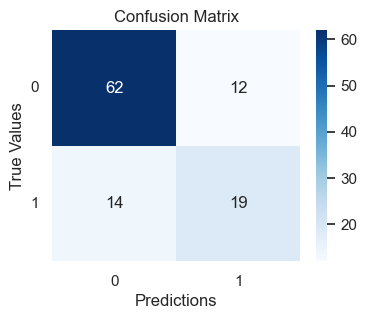

In [351]:
rfc1 = RandomForestClassifier(random_state=42)
rfc1.fit(X_train_df_without_zeros_scaled_PCA, y_train_df_without_zeros)

y_pred_df_without_zeros = rfc1.predict(X_test_df_without_zeros_scaled_PCA)

modelEvaluation(y_test_df_without_zeros, y_pred_df_without_zeros)

#### Testing Random Forest on df_median

Accuracy: 0.8701298701298701 

Classification Report:

               precision    recall  f1-score   support

           0       0.92      0.88      0.90        99
           1       0.80      0.85      0.82        55

    accuracy                           0.87       154
   macro avg       0.86      0.87      0.86       154
weighted avg       0.87      0.87      0.87       154



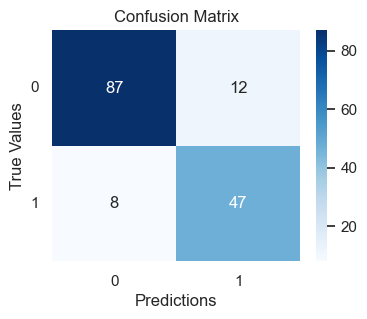

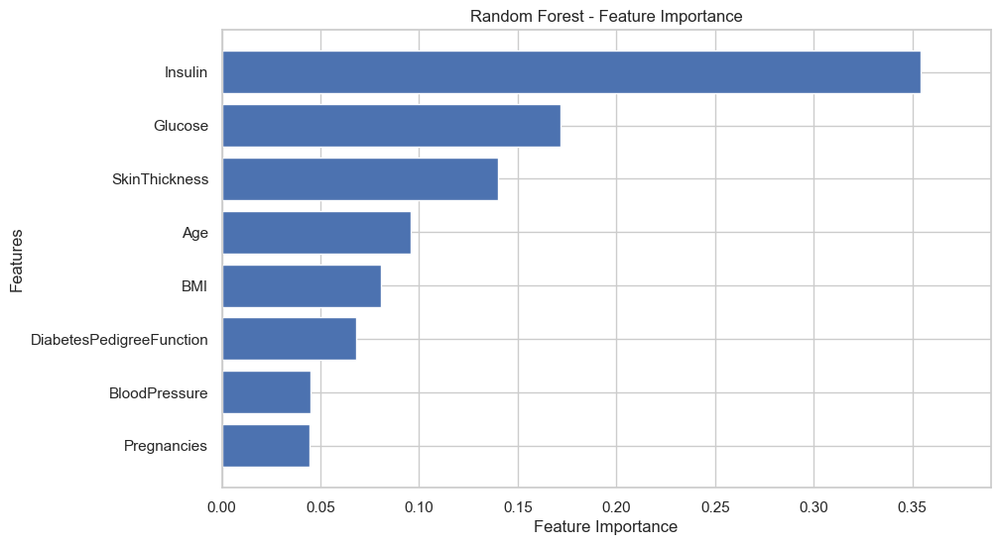

In [364]:
rfc2 = RandomForestClassifier(random_state=42)
rfc2.fit(X_train_df_median_scaled, y_train_df_median)

y_pred_df_median = rfc2.predict(X_test_df_median_scaled)

modelEvaluation(y_test_df_median, y_pred_df_median)
featureImportance(rfc2, df)

#### We see that it's better with df_median so let's do a Grid Search with them

In [234]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('rfc', RandomForestClassifier(random_state=42, n_estimators=100))
])

param_grid = {
    'rfc__criterion': ['gini', 'entropy', 'log_loss'], # Function to measure the quality of a split
    'rfc__max_depth': [None, 10, 20, 30, 40], # Maximum depth of each tree
    'rfc__min_samples_split': [2, 10, 20], # Minimum number of samples required to split a node
    'rfc__min_samples_leaf': [1, 5, 10], # Minimum number of samples required to be at a leaf node
    'rfc__max_features': [None, 'sqrt', 'log2'], # Number of features to consider when looking for the best split
    'rfc__bootstrap': [True, False], # Whether bootstrap samples are used when building trees. If False, the whole dataset is used to build each tree.
    'rfc__oob_score': [True, False],  # Whether to use out-of-bag samples to estimate the generalization score
    'rfc__max_leaf_nodes': [None, 10, 20, 30],  # Grow a tree with a max number of leaf nodes
}

grid_search = GridSearchCV(pipeline, param_grid, cv=3, scoring='accuracy', verbose=2)

grid_search.fit(X_train_df_median, y_train_df_median)

print("Meilleurs hyperparamètres:", grid_search.best_params_)

y_pred_df_median = grid_search.best_estimator_.predict(X_test_df_median)
print("Accuracy:", accuracy_score(y_test_df_median, y_pred_df_median))

Fitting 3 folds for each of 6480 candidates, totalling 19440 fits
[CV] END rfc__bootstrap=True, rfc__criterion=gini, rfc__max_depth=None, rfc__max_features=None, rfc__max_leaf_nodes=None, rfc__min_samples_leaf=1, rfc__min_samples_split=2, rfc__oob_score=True; total time=   0.0s
[CV] END rfc__bootstrap=True, rfc__criterion=gini, rfc__max_depth=None, rfc__max_features=None, rfc__max_leaf_nodes=None, rfc__min_samples_leaf=1, rfc__min_samples_split=2, rfc__oob_score=True; total time=   0.1s
[CV] END rfc__bootstrap=True, rfc__criterion=gini, rfc__max_depth=None, rfc__max_features=None, rfc__max_leaf_nodes=None, rfc__min_samples_leaf=1, rfc__min_samples_split=2, rfc__oob_score=True; total time=   0.1s
[CV] END rfc__bootstrap=True, rfc__criterion=gini, rfc__max_depth=None, rfc__max_features=None, rfc__max_leaf_nodes=None, rfc__min_samples_leaf=1, rfc__min_samples_split=2, rfc__oob_score=False; total time=   0.0s
[CV] END rfc__bootstrap=True, rfc__criterion=gini, rfc__max_depth=None, rfc__max_

c:\Python311\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
4860 fits failed out of a total of 19440.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4860 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Python311\Lib\site-packages\sklearn\base.py", line 1473, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Python311\Lib\site-packages\sklearn\pipeline.py", line 473, in fit
    self._final_estimator.fit(Xt, y, **last_step_params["fit"])
  File

Meilleurs hyperparamètres: {'rfc__bootstrap': True, 'rfc__criterion': 'gini', 'rfc__max_depth': None, 'rfc__max_features': 'sqrt', 'rfc__max_leaf_nodes': None, 'rfc__min_samples_leaf': 1, 'rfc__min_samples_split': 10, 'rfc__oob_score': True}
Accuracy: 0.8766233766233766


#### Finally, we test the best combination of hyperparameters on the Random Forest

Here, we increase the number of esitmators so that the grid search doesn't take too long to compute. So we find that the best number of estimators is 200.

Accuracy: 0.8896103896103896 

Classification Report:

               precision    recall  f1-score   support

           0       0.93      0.90      0.91        99
           1       0.83      0.87      0.85        55

    accuracy                           0.89       154
   macro avg       0.88      0.89      0.88       154
weighted avg       0.89      0.89      0.89       154



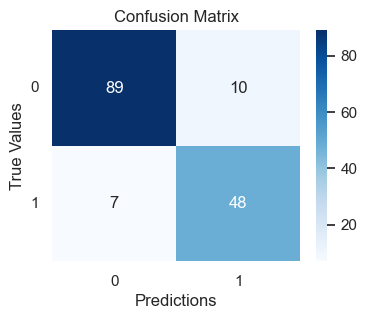

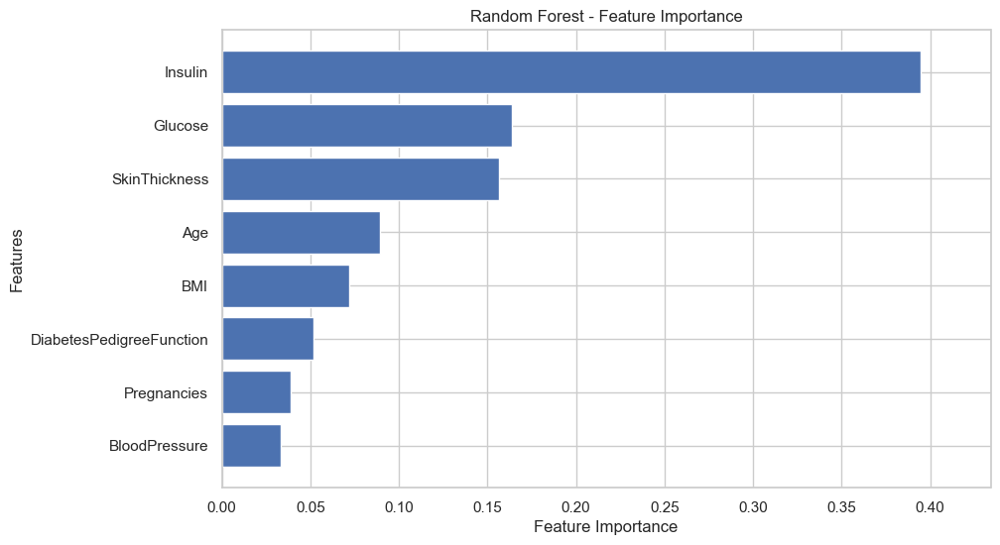

In [365]:
rfc3 = RandomForestClassifier(random_state=42, n_estimators=200, bootstrap=True, criterion='gini', max_depth=None, max_features='sqrt', max_leaf_nodes=None, min_samples_leaf=1, min_samples_split=10, oob_score=True)

rfc3.fit(X_train_df_median, y_train_df_median)

y_pred_df_median = rfc3.predict(X_test_df_median)

modelEvaluation(y_test_df_median, y_pred_df_median)
featureImportance(rfc3, df)
addMetrics('RandomForestClassifier', y_test_df_median, y_pred_df_median)

## Conclusion

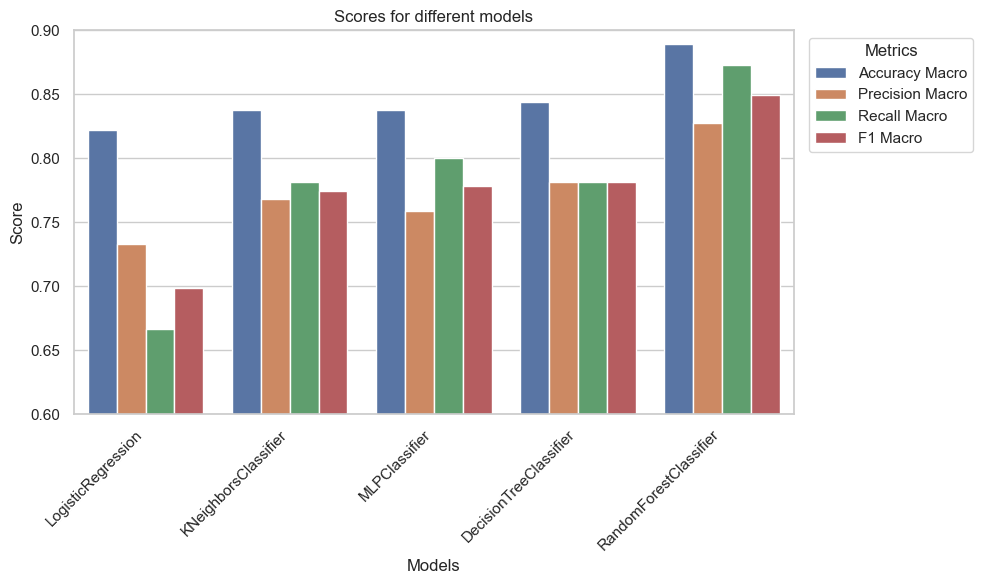

In [367]:
metrics_models_df = pd.DataFrame(metrics_models)
metrics_models_df_melted = metrics_models_df.melt(id_vars='Name', var_name='Metric', value_name='Score')

plt.figure(figsize=(10, 6))
sns.barplot(x='Name', y='Score', hue='Metric', data=metrics_models_df_melted)
plt.title('Scores for different models')
plt.xlabel('Models')
plt.ylabel('Score')
plt.ylim(0.6, 0.90)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Metrics', bbox_to_anchor=(1.01, 1), loc=2)
plt.tight_layout()
plt.show()

**After an in-depth analysis of the dataset, we concluded that it was important to create two DataFrames to better manage the outliers in the Insulin, SkinThickness, Glucose, BloodPressure and BMI columns:**
- df_without_zeros: where we remove rows containing outliers. We then applied the PCA method, which reduced the dimension of the DataFrame to 7 and standardized the data.
- df_median: where rows containing outliers are replaced by the median of each column. This avoids over-aligning the data, while at the same time removing spurious data. We then standardized the data.

I've decided to try out all the machine learning algorithms I've seen in class on the two DataFrames and then apply them. After which, I select the best of the DataFrames to apply a gridsearch on it to find the best hyperparameters for the model in question.

**Here's a summary of the results:**
- Regression Logistic: df_without_zeros gives rather good results, with an accuracy score of 82%. This is quite logical, as Regression Logistic is a linear model that is more efficient on low-dimensional data, which have been reduced thanks to PCA. 
- K-Nearest Neighbors: We obtain an accuracy score of 83% using df_median.
- Multi-layer Perceptron Classifier: We obtained an accuracy score of 83% using df_median and an F1 score slightly higher than that of KNN, but this remains rather disappointing for a neural network that takes much longer to compute than a simple KNN.
- Decision Tree: We obtain an accuracy score of 84% with df_median, which is better than the others, but will undoubtedly be higher using a Random Forest. The reason why df_median works better than Decision Tree or Random Forest is that this kind of model adapts directly to the raw data, so doing a PCA makes no sense and is more likely to hinder them.
- Random Forest: Finally, we get an accuray scor of 89%, which is really good.


**But the question now is, why is random forest the best performer here?**

The most likely reason is that there are different types of diabetes that are not taken into account in this dataset. We therefore unknowingly have different “groups” within the diabetic samples. This creates differences between them. And this can greatly alter certain models, notably the KNN. On the other hand, Random Forest can detect significant patterns in the data. It is thus better able to adapt to the complex structure of the information, which explains why it can offer superior performance in diabetes classification.